# Análisis geoespacial

In [368]:
import pandas as pd
import folium
import pandas as pd
from folium.plugins import HeatMap, MarkerCluster, MiniMap
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import numpy as np
import branca.colormap as bcm
import ipywidgets as widgets
import pycountry
from IPython.display import display, clear_output
import seaborn as sns

In [231]:
url = "https://docs.google.com/spreadsheets/d/1knlif89Nq26lnw1TH7NI163FgR3mktPp/export?format=csv"
data = pd.read_csv(url)

In [232]:
url = 'https://docs.google.com/spreadsheets/d/1J066cPGY3pt5w6hFddWuqV3VcrOJ9McV/export?format=csv'
location = pd.read_csv(url, skiprows = 10, skipfooter= 9, engine = 'python')
location.rename(columns={'Código .1': 'Código Municipio', 'Nombre.1':'Nombre Municipio'}, inplace=True)
location

,Código,Nombre,Código Municipio,Nombre Municipio,Unnamed: 4,Longitud,Latitud,Unnamed: 7
0,5,ANTIOQUIA,5001,MEDELLÍN,Municipio,"-75,581775","6,246631",NaN
1,5,ANTIOQUIA,5002,ABEJORRAL,Municipio,"-75,428739","5,789315",NaN
2,5,ANTIOQUIA,5004,ABRIAQUÍ,Municipio,"-76,064304","6,632282",NaN
3,5,ANTIOQUIA,5021,ALEJANDRÍA,Municipio,"-75,141346","6,376061",NaN
4,5,ANTIOQUIA,5030,AMAGÁ,Municipio,"-75,702188","6,038708",NaN
...,...,...,...,...,...,...,...,...
1117,97,VAUPÉS,97889,YAVARATÉ,Área no municipalizada,"-69,203337","0,609142",NaN
1118,99,VICHADA,99001,PUERTO CARREÑO,Municipio,"-67,487095","6,186636",NaN
1119,99,VICHADA,99524,LA PRIMAVERA,Municipio,"-70,410515","5,486309",NaN
1120,99,VICHADA,99624,SANTA ROSALÍA,Municipio,"-70,859499","5,136393",NaN


In [262]:
data

,COD_DPTO,COD_MUNIC,A_DEFUN,SIT_DEFUN,COD_INST,NOM_INST,ANO,MES,SEXO,EST_CIVIL,...,C_PAT1,C_PAT2,C_BAS1,C_MCM1,IDPROFCER,CAUSA_666_667,CAU_HOMOL,QUINQ,EDAD2,Código Municipio
0,76,364,1,2,,,"2,006",02,1,1,...,,,C189,,,202,14,05A09,15a19,76364
1,76,109,1,1,761090395501,E.S.E. HOSPITAL DEPARTAMENTAL DE BU,"2,006",05,2,1,...,,,C189,,,202,14,05A09,15a19,76109
2,66,1,1,1,660010079601,CL PIO XII,"2,006",05,2,3,...,,,C187,,,202,14,05A09,15a19,66001
3,63,1,1,1,630010031901,CL CENTRAL DEL QUINDIO,"2,006",10,2,4,...,C189,,C189,,,202,14,05A09,15a19,63001
4,11,1,1,1,1100114771,FUNDA SANTA FE,"2,006",08,2,2,...,,,C189,,,202,14,05A09,15a19,11001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65530,68,861,1,1,688610079501,ESE HOSPITAL REGIONAL DE VELEZ,"2,017",08,1,1,...,K566,,C189,,1,202,14,15A19,85y+,68861
65531,11,1,1,1,110011613301,HOSPITAL INFANTIL UNIVERSITARIO DE SAN JOSE,"2,017",09,2,3,...,J449,E46,C189,,1,202,14,15A19,85y+,11001
65532,73,1,1,1,730010199601,CL?NICA SALUDCOOP IBAGU?,"2,017",09,1,3,...,C189,,C189,,1,202,14,15A19,85y+,73001
65533,81,1,1,1,810010007701,HOSPITAL SAN VICENTE ESE,"2,017",10,2,3,...,,,C189,,1,202,14,15A19,85y+,81001


In [263]:
data['Código Municipio'] = data['COD_MUNIC'] + (data['COD_DPTO'] * 1000)
location_nd = location.drop_duplicates(subset=['Código Municipio'])
data_loc = pd.merge(data, location_nd[['Código Municipio', 'Nombre Municipio', 'Nombre', 'Longitud', 'Latitud']], on='Código Municipio', how='inner')

In [264]:
data_loc

,COD_DPTO,COD_MUNIC,A_DEFUN,SIT_DEFUN,COD_INST,NOM_INST,ANO,MES,SEXO,EST_CIVIL,...,IDPROFCER,CAUSA_666_667,CAU_HOMOL,QUINQ,EDAD2,Código Municipio,Nombre Municipio,Nombre,Longitud,Latitud
0,76,364,1,2,,,"2,006",02,1,1,...,,202,14,05A09,15a19,76364,JAMUNDÍ,VALLE DEL CAUCA,"-76,538472","3,258751"
1,76,109,1,1,761090395501,E.S.E. HOSPITAL DEPARTAMENTAL DE BU,"2,006",05,2,1,...,,202,14,05A09,15a19,76109,BUENAVENTURA,VALLE DEL CAUCA,"-77,01074","3,875708"
2,66,1,1,1,660010079601,CL PIO XII,"2,006",05,2,3,...,,202,14,05A09,15a19,66001,PEREIRA,RISARALDA,"-75,719711","4,804985"
3,63,1,1,1,630010031901,CL CENTRAL DEL QUINDIO,"2,006",10,2,4,...,,202,14,05A09,15a19,63001,ARMENIA,QUINDÍO,"-75,680786","4,53598"
4,11,1,1,1,1100114771,FUNDA SANTA FE,"2,006",08,2,2,...,,202,14,05A09,15a19,11001,"BOGOTÁ, D.C.","BOGOTÁ, D.C.","-74,106992","4,649251"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65530,68,861,1,1,688610079501,ESE HOSPITAL REGIONAL DE VELEZ,"2,017",08,1,1,...,1,202,14,15A19,85y+,68861,VÉLEZ,SANTANDER,"-73,672447","6,009275"
65531,11,1,1,1,110011613301,HOSPITAL INFANTIL UNIVERSITARIO DE SAN JOSE,"2,017",09,2,3,...,1,202,14,15A19,85y+,11001,"BOGOTÁ, D.C.","BOGOTÁ, D.C.","-74,106992","4,649251"
65532,73,1,1,1,730010199601,CL?NICA SALUDCOOP IBAGU?,"2,017",09,1,3,...,1,202,14,15A19,85y+,73001,IBAGUÉ,TOLIMA,"-75,19425","4,432248"
65533,81,1,1,1,810010007701,HOSPITAL SAN VICENTE ESE,"2,017",10,2,3,...,1,202,14,15A19,85y+,81001,ARAUCA,ARAUCA,"-70,747408","7,072726"


## Densidad de defunciones por municipio

In [265]:
geojson_url = "https://gist.githubusercontent.com/john-guerra/43c7656821069d00dcbc/raw/be6a6e239cd5b5b803c6e7c2ec405b793a9064dd/Colombia.geo.json"
base_map = gpd.read_file(geojson_url)

In [266]:
data_agg = data_loc.groupby(['Nombre Municipio', 'ANO']).size().reset_index(name='Casos')
data_mapa = pd.merge(data_agg, location, on='Nombre Municipio', how='left')

Corresponden a las defunciones por municipios en cada año.

In [267]:
data_mapa

,Nombre Municipio,ANO,Casos,Código,Nombre,Código Municipio,Unnamed: 4,Longitud,Latitud,Unnamed: 7
0,ABEJORRAL,"1,985",5,5,ANTIOQUIA,5002,Municipio,"-75,428739","5,789315",NaN
1,ABEJORRAL,"1,986",1,5,ANTIOQUIA,5002,Municipio,"-75,428739","5,789315",NaN
2,ABEJORRAL,"1,989",1,5,ANTIOQUIA,5002,Municipio,"-75,428739","5,789315",NaN
3,ABEJORRAL,"1,992",3,5,ANTIOQUIA,5002,Municipio,"-75,428739","5,789315",NaN
4,ABEJORRAL,"1,995",1,5,ANTIOQUIA,5002,Municipio,"-75,428739","5,789315",NaN
...,...,...,...,...,...,...,...,...,...,...
10751,ÚMBITA,"2,005",1,15,BOYACÁ,15842,Municipio,"-73,456917","5,221176",NaN
10752,ÚMBITA,"2,007",1,15,BOYACÁ,15842,Municipio,"-73,456917","5,221176",NaN
10753,ÚMBITA,"2,016",1,15,BOYACÁ,15842,Municipio,"-73,456917","5,221176",NaN
10754,ÚTICA,"1,989",1,25,CUNDINAMARCA,25851,Municipio,"-74,483154","5,19055",NaN


In [268]:
data_mapa = data_mapa.dropna(subset=['Latitud', 'Longitud', 'Casos'])
data_mapa['Latitud'] = data_mapa['Latitud'].str.replace(',', '.').astype(float)
data_mapa['Longitud'] = data_mapa['Longitud'].str.replace(',', '.').astype(float)

In [343]:
m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=5)
heat_data = [[row['Latitud'], row['Longitud'], row['Casos']] for _, row in data_mapa.iterrows()]
HeatMap(heat_data, radius=15, blur=10, max_zoom=5).add_to(m)
MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m


Similar al heatmap de la población en Colombia. Es necesario realizar un análisis proporcional a la población por departamento. 

### Marker clustering de defunciones


In [345]:
data_mapa

,Nombre Municipio,ANO,Casos,Código,Nombre,Código Municipio,Unnamed: 4,Longitud,Latitud,Unnamed: 7
0,ABEJORRAL,"1,985",5,5,ANTIOQUIA,5002,Municipio,-75.428739,5.789315,NaN
1,ABEJORRAL,"1,986",1,5,ANTIOQUIA,5002,Municipio,-75.428739,5.789315,NaN
2,ABEJORRAL,"1,989",1,5,ANTIOQUIA,5002,Municipio,-75.428739,5.789315,NaN
3,ABEJORRAL,"1,992",3,5,ANTIOQUIA,5002,Municipio,-75.428739,5.789315,NaN
4,ABEJORRAL,"1,995",1,5,ANTIOQUIA,5002,Municipio,-75.428739,5.789315,NaN
...,...,...,...,...,...,...,...,...,...,...
10751,ÚMBITA,"2,005",1,15,BOYACÁ,15842,Municipio,-73.456917,5.221176,NaN
10752,ÚMBITA,"2,007",1,15,BOYACÁ,15842,Municipio,-73.456917,5.221176,NaN
10753,ÚMBITA,"2,016",1,15,BOYACÁ,15842,Municipio,-73.456917,5.221176,NaN
10754,ÚTICA,"1,989",1,25,CUNDINAMARCA,25851,Municipio,-74.483154,5.190550,NaN


In [346]:
m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=5)

mc = MarkerCluster()
for _, row in data_mapa.iterrows():
    mc.add_child(folium.Marker(location=[row['Latitud'], row['Longitud']],
                  popup=f"{row['Nombre Municipio']}: {row['Casos']} en {row['ANO']}").add_to(mc))   
m.add_child(mc)
MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m

### Densidad de defunciones por municipio con filtro anual

> NO FUNCIONA EL HTML ! REVISAR IPYNB

In [307]:
año_slider = widgets.SelectionSlider(
    options=sorted(data_mapa['ANO'].unique()),
    description='Año:',
    value=data_mapa['ANO'].min(),
    continuous_update=False,
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='1200px')
)

def actualizar_mapa(año_seleccionado):
    clear_output(wait=True)
    
    m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=6)
    df_filtrado = data_mapa[data_mapa['ANO'] == año_seleccionado]

    if not df_filtrado.empty:
        heat_data = [[row['Latitud'], row['Longitud'], row['Casos']] for _, row in df_filtrado.iterrows()]
        HeatMap(heat_data, radius=15, blur=10, max_zoom=1).add_to(m)
    MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
    display(m)

mapa_interactivo = widgets.interactive_output(actualizar_mapa, {'año_seleccionado': año_slider})
display(año_slider, mapa_interactivo)



SelectionSlider(continuous_update=False, description='Año:', layout=Layout(width='1200px'), options=('1,985', …

Output()

### Densidad de defunciones proporcional al departamento



In [271]:
url = 'https://docs.google.com/spreadsheets/d/1jj_pL8c-zgkV9U24AWpoXBM-0-MdNZdQyztJtP4VJy4/export?format=csv'
population = pd.read_csv(url)
population['Unnamed: 0'] = population['Unnamed: 0'].str.upper()
population = population.rename(columns={'Unnamed: 0': 'DEPARTAMENTO'})
population

,DEPARTAMENTO,1985,1986,1987,1988,1989,1990,1991,1992,1993,...,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
0,BOGOTÁ,4225649,4360948,4502390,4648463,4797534,4947890,5105935,5261692,5413484,...,7467804,7571345,7674366,7776845,7878783,7980001,8080734,8181047,8281030,8380801
1,ANTIOQUIA,4118871,4193917,4269519,4345636,4422308,4499434,4577269,4655495,4734055,...,6143809,6221817,6299990,6378132,6456299,6534857,6613118,6691030,6768388,6845093
2,VALLE,3041474,3104541,3171288,3240825,3312817,3385688,3460164,3532718,3602190,...,4428675,4474369,4520480,4566875,4613684,4660741,4708262,4756113,4804489,4853327
3,CUNDINAMARCA,1563498,1596364,1627586,1657734,1687391,1717131,1745430,1774777,1805568,...,2517215,2557623,2598245,2639059,2680041,2721368,2762784,2804238,2845668,2887005
4,ATLÁNTICO,1516055,1550758,1586111,1621874,1657967,1694124,1730433,1766273,1801384,...,2344077,2373550,2402910,2432003,2460863,2489514,2517897,2545924,2573591,2600904
5,BOLÍVAR,1305302,1337290,1372254,1409379,1447832,1486750,1529558,1570959,1610019,...,2002531,2025573,2049109,2073004,2097161,2121956,2146696,2171280,2195495,2219139
6,SANTANDER,1577716,1601793,1626899,1652623,1678564,1704337,1731399,1757452,1782103,...,2020604,2030775,2040932,2051022,2061079,2071016,2080938,2090839,2100704,2110580
7,NARIÑO,1136533,1160391,1183777,1206625,1228944,1250735,1270428,1289606,1315954,...,1660062,1680795,1701782,1722945,1744228,1765906,1787545,1809116,1830473,1851477
8,CÓRDOBA,1056197,1076561,1096626,1116468,1136188,1155891,1175395,1195055,1214907,...,1607519,1632637,1658067,1683782,1709644,1736170,1762530,1788507,1813854,1838371
9,CAUCA,953449,972489,992008,1011792,1031644,1051355,1071687,1091442,1110442,...,1330756,1342650,1354733,1366984,1379169,1391836,1404205,1415933,1426938,1436916


In [272]:
print(data_loc['Nombre'].unique())

print(population['DEPARTAMENTO'].unique())

population['DEPARTAMENTO'] = population['DEPARTAMENTO'].replace(
    {'BOGOTÁ': 'BOGOTÁ, D.C.',
     'ARCHIPIÉLAGO DE SAN ANDRÉS': 'ARCHIPIÉLAGO DE SAN ANDRÉS, PROVIDENCIA Y SANTA CATALINA',
     'QUINDIO':'QUINDÍO',
     'VALLE':'VALLE DEL CAUCA'},
    regex=True
)

['VALLE DEL CAUCA' 'RISARALDA' 'QUINDÍO' 'BOGOTÁ, D.C.' 'ARAUCA'
 'SANTANDER' 'META' 'BOYACÁ' 'CASANARE' 'PUTUMAYO' 'NARIÑO' 'HUILA'
 'ARCHIPIÉLAGO DE SAN ANDRÉS, PROVIDENCIA Y SANTA CATALINA' 'ATLÁNTICO'
 'AMAZONAS' 'GUAVIARE' 'VICHADA' 'ANTIOQUIA' 'CÓRDOBA' 'BOLÍVAR'
 'NORTE DE SANTANDER' 'CALDAS' 'CHOCÓ' 'LA GUAJIRA' 'MAGDALENA' 'TOLIMA'
 'CUNDINAMARCA' 'CAQUETÁ' 'CAUCA' 'CESAR' 'SUCRE' 'VAUPÉS' 'GUAINÍA']
['BOGOTÁ' 'ANTIOQUIA' 'VALLE' 'CUNDINAMARCA' 'ATLÁNTICO' 'BOLÍVAR'
 'SANTANDER' 'NARIÑO' 'CÓRDOBA' 'CAUCA' 'TOLIMA' 'NORTE DE SANTANDER'
 'MAGDALENA' 'BOYACÁ' 'HUILA' 'LA GUAJIRA' 'CESAR' 'META' 'CALDAS'
 'RISARALDA' 'SUCRE' 'QUINDIO' 'CHOCÓ' 'CAQUETÁ' 'CASANARE' 'PUTUMAYO'
 'ARAUCA' 'GUAVIARE' 'VICHADA' 'AMAZONAS' 'ARCHIPIÉLAGO DE SAN ANDRÉS'
 'VAUPÉS' 'GUAINÍA']


In [273]:
data_prop = data_loc.groupby(['Nombre', 'ANO']).size().reset_index(name='Casos')

In [274]:
data_prop['ANO'] = data_prop['ANO'].replace(',', '', regex=True)

In [275]:
data_prop['Nombre'].unique()

array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIÉLAGO DE SAN ANDRÉS, PROVIDENCIA Y SANTA CATALINA',
       'ATLÁNTICO', 'BOGOTÁ, D.C.', 'BOLÍVAR', 'BOYACÁ', 'CALDAS',
       'CAQUETÁ', 'CASANARE', 'CAUCA', 'CESAR', 'CHOCÓ', 'CUNDINAMARCA',
       'CÓRDOBA', 'GUAINÍA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA',
       'MAGDALENA', 'META', 'NARIÑO', 'NORTE DE SANTANDER', 'PUTUMAYO',
       'QUINDÍO', 'RISARALDA', 'SANTANDER', 'SUCRE', 'TOLIMA',
       'VALLE DEL CAUCA', 'VAUPÉS', 'VICHADA'], dtype=object)

In [276]:
populationm = population.melt(id_vars=['DEPARTAMENTO'], var_name='ANO', value_name='Población')
data_prop = pd.merge(data_prop, populationm, left_on=['Nombre', 'ANO'], right_on=['DEPARTAMENTO', 'ANO'], how='left')
data_prop['Proporción'] = (data_prop['Casos'] / data_prop['Población']) * 100000

In [291]:
data_prop['Nombre'] = data_prop['Nombre'].replace({
    'ARCHIPIÉLAGO DE SAN ANDRÉS, PROVIDENCIA Y SANTA CATALINA': 'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
    'BOGOTÁ, D.C.': 'SANTAFE DE BOGOTA D.C.'
}, regex=True)

data_prop['Nombre'] = data_prop['Nombre'].replace({'Á': 'A', 'É': 'E', 'Í': 'I', 'Ó': 'O', 'Ú': 'U'}, regex=True)

> NO FUNCIONA EL HTML ! REVISAR IPYNB

In [308]:
data_prop['ANO'] = data_prop['ANO'].astype(str)

año_slider = widgets.SelectionSlider(
    options=sorted(data_prop['ANO'].unique(), reverse=True),
    description='Año:',
    value='1985',
    continuous_update=False,
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='1200px')
)

def actualizar_mapa(año_seleccionado):
    clear_output(wait=True)
    
    data_año = data_prop[data_prop['ANO'] == año_seleccionado]
    m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start = 6)
    colormap = bcm.LinearColormap(colors=["green", "yellow", "red"], vmin=0, vmax=data_año['Proporción'].max())
    data_año = base_map.merge(data_año[['Nombre', 'Proporción']], left_on='NOMBRE_DPT', right_on='Nombre', how='inner')

    folium.GeoJson(
        data_año,
        style_function=lambda feature: {
            "fillColor": colormap(feature["properties"].get("Proporción", 0.5)),
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.6
        },
        tooltip=folium.GeoJsonTooltip(fields=["Nombre", "Proporción"],
                                      aliases=["Departamento", "Proporción de cada 100,000 habitantes"])).add_to(m)

    colormap.caption = f"Defunción por cada 100,000 habitantes en {año_seleccionado}"
    colormap.add_to(m)
    MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
    display(m)

mapa_interactivo = widgets.interactive_output(actualizar_mapa, {'año_seleccionado': año_slider})
display(año_slider, mapa_interactivo)

SelectionSlider(continuous_update=False, description='Año:', index=34, layout=Layout(width='1200px'), options=…

Output()

## Densidad de municipio de residencia de los casos

> Repetir pero con variable `CODMUNRE` en vez de `COD_MUNIC` y `CODPTORE` en vez de `COD_DPTO`. Revisar diferencias entre residencia y defunción.

In [315]:
data[['CODMUNRE', 'CODPTORE']]

,CODMUNRE,CODPTORE
0,364,76
1,109,76
2,147,76
3,147,76
4,520,76
...,...,...
65530,324,68
65531,001,11
65532,001,73
65533,001,81


In [ ]:
for i in data['CODPRES'].unique():
    try:
        country = pycountry.countries.get(numeric=i)
        if country is not None:
            print(country.name)
    except LookupError:
        print(f"Country code {i} not found in pycountry.")

Colombia
Venezuela, Bolivarian Republic of
United States
Ecuador
Aruba
Russian Federation
Antigua and Barbuda
Netherlands
Spain
Germany
Panama


**Se limitó a residentes de Colombia.**

In [ ]:
temp = data[(data['CODPRES'] == '170') | (data['CODPRES'] == '')]
temp['Codigo residencia'] = temp['CODMUNRE'].astype(int) + (temp['CODPTORE'] * 1000)
location_ndm = location.drop_duplicates(subset=['Nombre Municipio'])
data_residencia = pd.merge(temp, location_ndm[['Código Municipio', 'Nombre Municipio', 'Nombre', 'Longitud', 'Latitud']], left_on ='Codigo residencia', right_on='Código Municipio', how='inner')

In [352]:
casos_residencia = data_residencia.groupby(['Nombre Municipio', 'ANO']).size().reset_index(name='Casos')
mapa_residencia = pd.merge(casos_residencia, location, on='Nombre Municipio', how='left')

In [355]:
mapa_residencia = mapa_residencia.dropna(subset=['Latitud', 'Longitud', 'Casos'])
mapa_residencia['Latitud'] = mapa_residencia['Latitud'].str.replace(',', '.').astype(float)
mapa_residencia['Longitud'] = mapa_residencia['Longitud'].str.replace(',', '.').astype(float)

In [360]:
m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=5)
heat_data = [[row['Latitud'], row['Longitud'], row['Casos']] for _, row in mapa_residencia.iterrows()]
HeatMap(heat_data, radius=15, blur=10, max_zoom=5).add_to(m)
MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m

Se destaca aparición de nuevas zonas sombreadas en el mapa, como *La Chorrera*, área no municipalizada en el departamento del *Amazonas* o *Carurú* en *Vaupés*, municipio de tan solo 3243 habitantes. Se realizará un análisis de aquellos registros en los que el sitio de defunción no coincida con el sitio de residencia para revisar variables derivadas como **distancia del centro de salud a la residencia** en [esta sección](#distance).

### Marker clustering de lugar de residencia habitual

In [361]:
m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=5)

mc = MarkerCluster()
for _, row in mapa_residencia.iterrows():
    mc.add_child(folium.Marker(location=[row['Latitud'], row['Longitud']],
                  popup=f"{row['Nombre Municipio']}: {row['Casos']} en {row['ANO']}").add_to(mc))   
m.add_child(mc)
MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m

## Género


In [283]:

data_sexo = data_loc.groupby(['Nombre', 'SEXO']).size().reset_index(name='Cantidad')
data_sexo['Nombre'] = data_sexo['Nombre'].replace({'ARCHIPIÉLAGO DE SAN ANDRÉS, PROVIDENCIA Y SANTA CATALINA':'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA', 'BOGOTÁ, D.C.':'SANTAFE DE BOGOTA D.C'}, regex=True)
data_sexo['Nombre'] = data_sexo['Nombre'].replace({'Á': 'A', 'É': 'E', 'Í': 'I', 'Ó': 'O', 'Ú': 'U'}, regex=True)
sexo_mayoritario = data_sexo.loc[data_sexo.groupby('Nombre')['Cantidad'].idxmax()]
mapa_sexo = base_map.merge(sexo_mayoritario, left_on='NOMBRE_DPT', right_on='Nombre', how='right')


In [309]:
def color_sexo(sexo):
    if sexo == 1: #Hombre
        return "blue"
    elif sexo == 2: #Mujer
        return "red"
    else:
        return "gray"

m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron',  zoom_start=5)

folium.GeoJson(
    mapa_sexo,
    style_function=lambda feature: {
        "fillColor": color_sexo(feature["properties"].get("SEXO")),
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.6
    },
    tooltip=folium.GeoJsonTooltip(fields=["NOMBRE_DPT", "SEXO"],
                                  aliases=["Departamento", "Sexo Mayoritario"])
).add_to(m)

MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m


> Inicialmente parecía haber una diferencia en la distribución de casos entre mujeres y hombres, pero al revisar proporcionalmente se ve que la diferencia no es significativa. 

### Género proporcional

In [312]:
data_pivot = data_sexo.pivot(index="Nombre", columns="SEXO", values="Cantidad").fillna(0)
data_pivot.columns = ["Hombres", "Mujeres"]
data_pivot = data_pivot.reset_index()

data_propsex = base_map.merge(data_pivot, left_on="NOMBRE_DPT", right_on="Nombre", how="inner")
data_propsex["proporcion_hombres"] = data_propsex["Hombres"] / (data_propsex["Hombres"] + data_propsex["Mujeres"])

m = folium.Map(location=[4.5709, -74.2973], tiles='cartodbpositron', zoom_start=5)

colormap = bcm.LinearColormap(colors=["red", "purple", "blue"], vmin=0, vmax=1)

folium.GeoJson(
    data_propsex,
    style_function=lambda feature: {
        "fillColor": colormap(feature["properties"].get("proporcion_hombres", 0.5)),
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.6
    },
    tooltip=folium.GeoJsonTooltip(fields=["NOMBRE_DPT", "proporcion_hombres"],
                                  aliases=["Departamento", "Proporción de Hombres"])
).add_to(m)

colormap.caption = "Proporción de Hombres (Rojo = más mujeres, Azul = más hombres)"
colormap.add_to(m)

MiniMap(toggle_display=True, tile_layer='cartodbpositron').add_to(m)
m

## Tipo de tumor

### Causa agrupada

La variable **`CAUSA_666_667`** determina la causa agrupada con base en la *lista 6/67 de la OPS*. En este caso, al tratarse de defunciones por cáncer colorectal, se tienen los códigos **202** y **203**, asociados a tumor maligno del colon y órganos digestivos y del peritoneo excluyendo colon y estómago respectivamente. 


> Error en las gráficas. Revisar merge, seguramente por las tildes. 

C:\Users\valen\AppData\Local\Temp\ipykernel_3920\301478898.py:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("coolwarm")
C:\Users\valen\AppData\Local\Temp\ipykernel_3920\301478898.py:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("coolwarm")


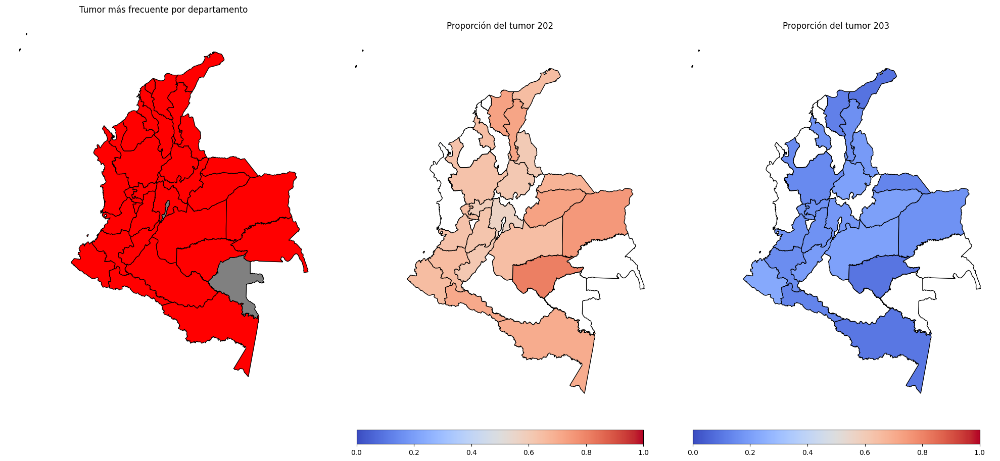

In [286]:
data_tumor = data_loc.groupby(['Nombre', 'CAUSA_666_667']).size().reset_index(name='Cantidad')
data_tumor["CAUSA_666_667"] = data_tumor["CAUSA_666_667"].replace(' ', np.nan)
data_tumor["CAUSA_666_667"] = data_tumor["CAUSA_666_667"].fillna(-1).astype(int)

categoria_mayoritaria = data_tumor.loc[data_tumor.groupby('Nombre')['Cantidad'].idxmax()]


categoria_mayoritaria['Nombre'] = categoria_mayoritaria['Nombre'].replace({'Á': 'A', 'É': 'E', 'Í': 'I', 'Ó': 'O', 'Ú': 'U'}, regex=True)

tumores = [202, 203,-1]
data_pivot = data_tumor.pivot(index="Nombre", columns="CAUSA_666_667", values="Cantidad").fillna(0)

for t in tumores:
    if t not in data_pivot.columns:
        data_pivot[t] = 0

data_pivot["Total"] = data_pivot[tumores].sum(axis=1)
for t in tumores:
    data_pivot[f"proporcion_{t}"] = data_pivot[t] / data_pivot["Total"]

data_pivot = data_pivot.reset_index()

mapa_tumor = base_map.merge(categoria_mayoritaria, left_on="NOMBRE_DPT", right_on="Nombre", how="left")
mapa_tumor = mapa_tumor.merge(data_pivot, on="Nombre", how="left")

categorias = {202: "red", 203: "blue"}
mapa_tumor["color_mayor"] = mapa_tumor["CAUSA_666_667"].map(lambda x: categorias.get(x, "gray"))

fig, axes = plt.subplots(1, 3, figsize=(20, 10))

mapa_tumor.plot(ax=axes[0], color=mapa_tumor["color_mayor"], edgecolor="black")
axes[0].set_title("Tumor más frecuente por departamento")
axes[0].set_xticks([])
axes[0].set_yticks([])
axes[0].set_frame_on(False)

tumores = [202, 203]
for i, causa in enumerate(tumores):
    cmap = cm.get_cmap("coolwarm")
    norm = mcolors.Normalize(vmin=0, vmax=1)

    if f"proporcion_{causa}" in mapa_tumor.columns:
        valores_color = [
            cmap(norm(value)) if pd.notna(value) else (1, 1, 1, 0)  # Transparente si es NaN
            for value in mapa_tumor[f"proporcion_{causa}"]
        ]
        mapa_tumor.plot(ax=axes[i+1], color=valores_color, edgecolor="black")

    axes[i+1].set_title(f"Proporción del tumor {causa}")
    axes[i+1].set_xticks([])
    axes[i+1].set_yticks([])
    axes[i+1].set_frame_on(False)

    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=axes[i+1], orientation="horizontal", fraction=0.03, pad=0.04)

plt.tight_layout()
plt.show()


### Causa básica de la defunción

`C_BAS1` determina el código de la causa básica de defunción, sin datos faltantes. Es un código y están listados en el **CIE10** p **CIE9**, bajo el código **COD_4**. Se pueden agrupar de manera más general con **COD_3**.

Los valores únicos correspondientes son, con la clasificación internacional de enfermedades revisión 10,

1. **C189**: Neoplasia maligna del colon, parte no especificada.  
2. **C187**: Neoplasia maligna del colon sigmoide.  
3. **C20X**: Neoplasia maligna del recto.  
4. **C19X**: Neoplasia maligna de la unión rectosigmoidea.  
5. **C210**: Neoplasia maligna del ano, no especificada.  
6. **C211**: Neoplasia maligna del conducto anal.  
7. **C182**: Neoplasia maligna del colon ascendente.  
8. **C180**: Neoplasia maligna del ciego.  
9. **C218**: Neoplasia maligna de otras partes del recto.  
10. **C20**: Neoplasia maligna del recto.  
11. **C188**: Neoplasia maligna de otras partes del colon.  
12. **C184**: Neoplasia maligna del colon transverso.  
13. **C19**: Neoplasia maligna de la unión rectosigmoidea.  
14. **C181**: Neoplasia maligna del colon hepático.  
15. **C185**: Neoplasia maligna del colon descendente.  
16. **C183**: Neoplasia maligna de la flexura esplénica del colon.  
17. **C186**: Neoplasia maligna del colon sigmoide.  
18. **C212**: Neoplasia maligna del ano y del conducto anal, parte no especificada.  

Y con el CIE9,

19. **1539**: Neoplasia maligna del colon, parte no especificada.  
20. **1540**: Neoplasia maligna del recto.  
21. **1541**: Neoplasia maligna de la unión rectosigmoidea.  
22. **1533**: Neoplasia maligna del colon sigmoide.  
23. **1534**: Neoplasia maligna de la flexura esplénica del colon.  
24. **1530**: Neoplasia maligna del ciego.  
25. **1536**: Neoplasia maligna del colon transverso.  
26. **1531**: Neoplasia maligna del colon ascendente.  
27. **1542**: Neoplasia maligna del ano.  
28. **1543**: Neoplasia maligna del conducto anal.  
29. **1548**: Neoplasia maligna de otras partes especificadas del recto, ano y conducto anal.  
30. **1535**: Neoplasia maligna del colon hepático.  
31. **1538**: Neoplasia maligna de otras partes del colon.  
32. **1532**: Neoplasia maligna del colon descendente.  
33. **1537**: Neoplasia maligna de la flexura hepática del colon.  

Además de otros adenomas o tumores benignos codificados en la revisión 9.

34. **2114**: Tumor benigno del recto y del canal anal.  
35. **2113**: Tumor benigno del colon.  


> https://web.sispro.gov.co/WebPublico/Consultas/ConsultarDetalleReferenciaBasica.aspx?Code=CIE10

> https://www.euskadi.eus/contenidos/informacion/5893/es_2290/adjuntos/Codigos_Diagnostico_Enfermedad.pdf



In [295]:
data['C_BAS1'].unique()

array(['C189', 'C187', 'C20X', 'C19X', 'C210', 'C211', 'C182', 'C180',
       'C218', 'C20', '1539', 'C188', 'C184', 'C19', '1540', '1541',
       '1533', '1534', '1530', '1536', '1531', '1542', '1543', 'C181',
       '1548', 'C185', '1535', 'C183', '1538', 'C186', '1532', '1537',
       'C212', '2114', '2113'], dtype=object)

> Realizar mapa de distribución de causas básicas.

In [377]:
codigos = ['C189', 'C187', 'C20X', 'C19X', 'C210', 'C211', 'C182', 'C180',
           'C218', 'C20', '1539', 'C188', 'C184', 'C19', '1540', '1541',
           '1533', '1534', '1530', '1536', '1531', '1542', '1543', 'C181',
           '1548', 'C185', '1535', 'C183', '1538', 'C186', '1532', '1537',
           'C212', '2114', '2113']
cie_dict = {
    'C189': 'Cáncer maligno del colon, parte no especificada',
    'C187': 'Cáncer maligno del colon sigmoide',
    'C20': 'Cáncer maligno del recto',
    'C19': 'Cáncer maligno de la unión rectosigmoidea',
    'C210': 'Cáncer maligno del ano',
    'C211': 'Cáncer maligno del conducto anal',
    'C182': 'Cáncer maligno del colon ascendente',
    'C180': 'Cáncer maligno del ciego',
    'C218': 'Cáncer maligno del intestino grueso, parte no especificada',
    'C188': 'Cáncer maligno del colon transverso',
    'C184': 'Cáncer maligno del colon descendente',
    'C181': 'Cáncer maligno del ángulo hepático del colon',
    'C185': 'Cáncer maligno del ángulo esplénico del colon',
    'C183': 'Cáncer maligno del colon sigmoide',
    'C186': 'Cáncer maligno del colon, parte no especificada',
    'C212': 'Cáncer maligno de la cloaca',

    '1530': 'Cáncer maligno del ciego',
    '1531': 'Cáncer maligno del colon ascendente',
    '1532': 'Cáncer maligno del colon transverso',
    '1533': 'Cáncer maligno del ángulo esplénico del colon',
    '1534': 'Cáncer maligno del colon descendente',
    '1535': 'Cáncer maligno del colon sigmoide',
    '1536': 'Cáncer maligno del colon, parte no especificada',
    '1537': 'Cáncer maligno del apéndice',
    '1538': 'Cáncer maligno del colon con lesiones múltiples',
    '1539': 'Cáncer maligno del colon, parte no especificada',
    '1540': 'Cáncer maligno de la unión rectosigmoidea',
    '1541': 'Cáncer maligno del recto',
    '1542': 'Cáncer maligno del ano, excluyendo el recto',
    '1543': 'Cáncer maligno del conducto anal',
    '1548': 'Cáncer colorrectal con sitios múltiples',
    
    '2113': 'Pólipos del colon',
    '2114': 'Pólipos del recto'
}

def dictcie(codigo):
    codigo = codigo.rstrip('X')
    return cie_dict.get(codigo, '')

CIE = pd.DataFrame({'Código': codigos})
CIE['Enfermedad'] = CIE['Código'].apply(dictcie)


Se redujo a **20 diagnósticos** unificando el sistema utilizado para su clasificación.

In [378]:
CIE['Enfermedad'].unique()

array(['Cáncer maligno del colon, parte no especificada',
       'Cáncer maligno del colon sigmoide', 'Cáncer maligno del recto',
       'Cáncer maligno de la unión rectosigmoidea',
       'Cáncer maligno del ano', 'Cáncer maligno del conducto anal',
       'Cáncer maligno del colon ascendente', 'Cáncer maligno del ciego',
       'Cáncer maligno del intestino grueso, parte no especificada',
       'Cáncer maligno del colon transverso',
       'Cáncer maligno del colon descendente',
       'Cáncer maligno del ángulo esplénico del colon',
       'Cáncer maligno del ano, excluyendo el recto',
       'Cáncer maligno del ángulo hepático del colon',
       'Cáncer colorrectal con sitios múltiples',
       'Cáncer maligno del colon con lesiones múltiples',
       'Cáncer maligno del apéndice', 'Cáncer maligno de la cloaca',
       'Pólipos del recto', 'Pólipos del colon'], dtype=object)

### Distribución de causa básica de defunción 

C:\Users\valen\AppData\Local\Temp\ipykernel_3920\1726154083.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=temp.index, y=temp.values, palette='gray')


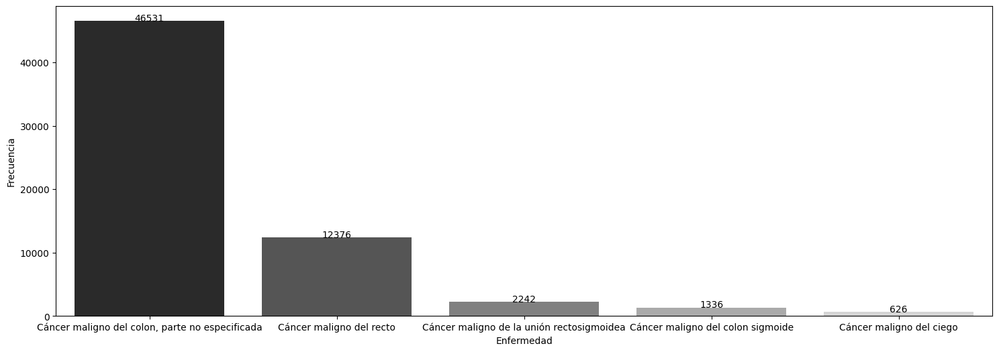

In [392]:
basicc =  pd.merge(data['C_BAS1'], CIE, left_on='C_BAS1', right_on='Código', how='inner')
temp = basicc['Enfermedad'].value_counts().head(5)

plt.figure(figsize=(18, 6))
sns.barplot(x=temp.index, y=temp.values, palette='gray')

for i, v in enumerate(temp.values):
    plt.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.xlabel("Enfermedad")
plt.ylabel("Frecuencia")

plt.show()

## Antecedentes

> Dividir causas agrupadas como antecedentes individuales. 

> Realizar conversión de CIE10 y 6/67 a nombres.

> Hacer Exploratorio.

<a id="distance"></a>
## Distancia a lugar de defunción o institución prestadora de salud.